### 1. Se pide:

A partir del archivo "USA_Housing.csv", realizar la regresión no lineal entre cada columna numérica con la columna 'price' utilizando:

- Regresión polinómica no lineal con grados del 2 al 10. ¿El score se estanca a partir de cierto grado?
- SVR

In [1]:
import pandas as pd

df = pd.read_csv("../data/USA_Housing.csv")
df

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price,Address
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06,"208 Michael Ferry Apt. 674\nLaurabury, NE 3701..."
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06,"188 Johnson Views Suite 079\nLake Kathleen, CA..."
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06,"9127 Elizabeth Stravenue\nDanieltown, WI 06482..."
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06,USS Barnett\nFPO AP 44820
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05,USNS Raymond\nFPO AE 09386
...,...,...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035,1.060194e+06,USNS Williams\nFPO AP 30153-7653
4996,78491.275435,6.999135,6.576763,4.02,25616.115489,1.482618e+06,"PSC 9258, Box 8489\nAPO AA 42991-3352"
4997,63390.686886,7.250591,4.805081,2.13,33266.145490,1.030730e+06,"4215 Tracy Garden Suite 076\nJoshualand, VA 01..."
4998,68001.331235,5.534388,7.130144,5.44,42625.620156,1.198657e+06,USS Wallace\nFPO AE 73316


In [2]:
# Import function to create training and test set splits
from sklearn.model_selection import train_test_split
# Import function to automatically create polynomial features! 
from sklearn.preprocessing import PolynomialFeatures
# Import Linear Regression
from sklearn.linear_model import LinearRegression
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.metrics import r2_score, mean_absolute_error

import numpy as np

In [3]:
X = df.drop(["Price", "Address"],1)
X

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population
0,79545.458574,5.682861,7.009188,4.09,23086.800503
1,79248.642455,6.002900,6.730821,3.09,40173.072174
2,61287.067179,5.865890,8.512727,5.13,36882.159400
3,63345.240046,7.188236,5.586729,3.26,34310.242831
4,59982.197226,5.040555,7.839388,4.23,26354.109472
...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035
4996,78491.275435,6.999135,6.576763,4.02,25616.115489
4997,63390.686886,7.250591,4.805081,2.13,33266.145490
4998,68001.331235,5.534388,7.130144,5.44,42625.620156


In [7]:
y = df['Price'].values
print(y.shape)


(5000,)


################
[[1.00000000e+00 7.17840162e+04 5.15294499e+09]
 [1.00000000e+00 7.61754939e+04 5.80270588e+09]
 [1.00000000e+00 6.94018472e+04 4.81661640e+09]
 ...
 [1.00000000e+00 6.67909603e+04 4.46103238e+09]
 [1.00000000e+00 5.99331380e+04 3.59198103e+09]
 [1.00000000e+00 5.99128239e+04 3.58954647e+09]]
(4000, 3)
y_pred (4000,)
Score: 0.40318757054408993


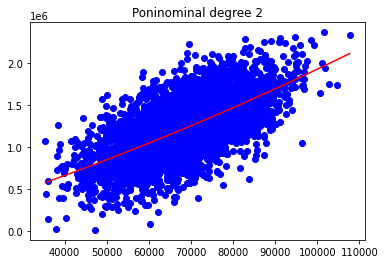

################
[[1.00000000e+00 7.17840162e+04 5.15294499e+09 3.69899087e+14]
 [1.00000000e+00 7.61754939e+04 5.80270588e+09 4.42023986e+14]
 [1.00000000e+00 6.94018472e+04 4.81661640e+09 3.34282075e+14]
 ...
 [1.00000000e+00 6.67909603e+04 4.46103238e+09 2.97956637e+14]
 [1.00000000e+00 5.99331380e+04 3.59198103e+09 2.15278695e+14]
 [1.00000000e+00 5.99128239e+04 3.58954647e+09 2.15059865e+14]]
(4000, 4)
y_pred (4000,)
Score: 0.4031944128636523


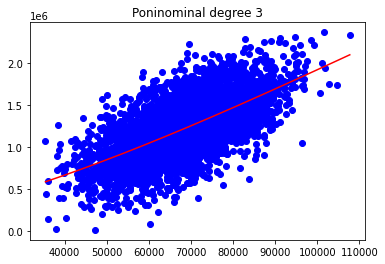

################
[[1.00000000e+00 7.17840162e+04 5.15294499e+09 3.69899087e+14
  2.65528420e+19]
 [1.00000000e+00 7.61754939e+04 5.80270588e+09 4.42023986e+14
  3.36713955e+19]
 [1.00000000e+00 6.94018472e+04 4.81661640e+09 3.34282075e+14
  2.31997935e+19]
 ...
 [1.00000000e+00 6.67909603e+04 4.46103238e+09 2.97956637e+14
  1.99008099e+19]
 [1.00000000e+00 5.99331380e+04 3.59198103e+09 2.15278695e+14
  1.29023277e+19]
 [1.00000000e+00 5.99128239e+04 3.58954647e+09 2.15059865e+14
  1.28848438e+19]]
(4000, 5)
y_pred (4000,)
Score: 0.4032310813129839


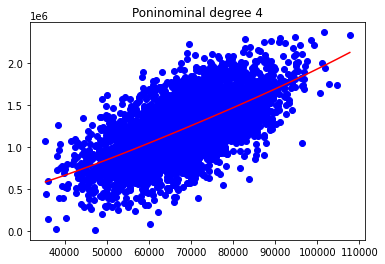

################
[[1.00000000e+00 7.17840162e+04 5.15294499e+09 3.69899087e+14
  2.65528420e+19 1.90606964e+24]
 [1.00000000e+00 7.61754939e+04 5.80270588e+09 4.42023986e+14
  3.36713955e+19 2.56493518e+24]
 [1.00000000e+00 6.94018472e+04 4.81661640e+09 3.34282075e+14
  2.31997935e+19 1.61010853e+24]
 ...
 [1.00000000e+00 6.67909603e+04 4.46103238e+09 2.97956637e+14
  1.99008099e+19 1.32919421e+24]
 [1.00000000e+00 5.99331380e+04 3.59198103e+09 2.15278695e+14
  1.29023277e+19 7.73276987e+23]
 [1.00000000e+00 5.99128239e+04 3.58954647e+09 2.15059865e+14
  1.28848438e+19 7.71967380e+23]]
(4000, 6)
y_pred (4000,)
Score: 0.40333318553794817


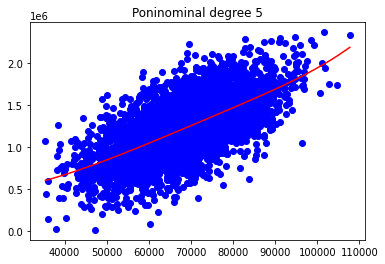

################
[[1.00000000e+00 7.17840162e+04 5.15294499e+09 ... 2.65528420e+19
  1.90606964e+24 1.36825334e+29]
 [1.00000000e+00 7.61754939e+04 5.80270588e+09 ... 3.36713955e+19
  2.56493518e+24 1.95385204e+29]
 [1.00000000e+00 6.94018472e+04 4.81661640e+09 ... 2.31997935e+19
  1.61010853e+24 1.11744506e+29]
 ...
 [1.00000000e+00 6.67909603e+04 4.46103238e+09 ... 1.99008099e+19
  1.32919421e+24 8.87781575e+28]
 [1.00000000e+00 5.99331380e+04 3.59198103e+09 ... 1.29023277e+19
  7.73276987e+23 4.63449164e+28]
 [1.00000000e+00 5.99128239e+04 3.58954647e+09 ... 1.28848438e+19
  7.71967380e+23 4.62507457e+28]]
(4000, 7)
y_pred (4000,)
Score: 0.40333578290184313


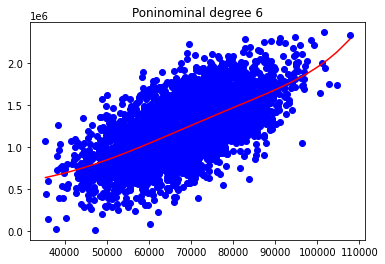

################
[[1.00000000e+00 7.17840162e+04 5.15294499e+09 ... 1.90606964e+24
  1.36825334e+29 9.82187202e+33]
 [1.00000000e+00 7.61754939e+04 5.80270588e+09 ... 2.56493518e+24
  1.95385204e+29 1.48835644e+34]
 [1.00000000e+00 6.94018472e+04 4.81661640e+09 ... 1.61010853e+24
  1.11744506e+29 7.75527512e+33]
 ...
 [1.00000000e+00 6.67909603e+04 4.46103238e+09 ... 1.32919421e+24
  8.87781575e+28 5.92957839e+33]
 [1.00000000e+00 5.99331380e+04 3.59198103e+09 ... 7.73276987e+23
  4.63449164e+28 2.77759627e+33]
 [1.00000000e+00 5.99128239e+04 3.58954647e+09 ... 7.71967380e+23
  4.62507457e+28 2.77101278e+33]]
(4000, 8)
y_pred (4000,)
Score: 0.40287553349969596


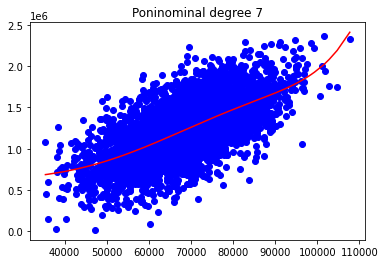

################
[[1.00000000e+00 7.17840162e+04 5.15294499e+09 ... 1.36825334e+29
  9.82187202e+33 7.05053420e+38]
 [1.00000000e+00 7.61754939e+04 5.80270588e+09 ... 1.95385204e+29
  1.48835644e+34 1.13376287e+39]
 [1.00000000e+00 6.94018472e+04 4.81661640e+09 ... 1.11744506e+29
  7.75527512e+33 5.38230419e+38]
 ...
 [1.00000000e+00 6.67909603e+04 4.46103238e+09 ... 8.87781575e+28
  5.92957839e+33 3.96042235e+38]
 [1.00000000e+00 5.99331380e+04 3.59198103e+09 ... 4.63449164e+28
  2.77759627e+33 1.66470060e+38]
 [1.00000000e+00 5.99128239e+04 3.58954647e+09 ... 4.62507457e+28
  2.77101278e+33 1.66019201e+38]]
(4000, 9)
y_pred (4000,)
Score: 0.4014806542340641


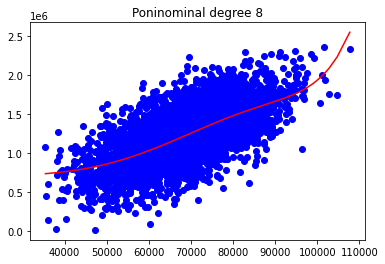

################
[[1.00000000e+00 7.17840162e+04 5.15294499e+09 ... 9.82187202e+33
  7.05053420e+38 5.06115662e+43]
 [1.00000000e+00 7.61754939e+04 5.80270588e+09 ... 1.48835644e+34
  1.13376287e+39 8.63649469e+43]
 [1.00000000e+00 6.94018472e+04 4.81661640e+09 ... 7.75527512e+33
  5.38230419e+38 3.73541853e+43]
 ...
 [1.00000000e+00 6.67909603e+04 4.46103238e+09 ... 5.92957839e+33
  3.96042235e+38 2.64520412e+43]
 [1.00000000e+00 5.99331380e+04 3.59198103e+09 ... 2.77759627e+33
  1.66470060e+38 9.97707310e+42]
 [1.00000000e+00 5.99128239e+04 3.58954647e+09 ... 2.77101278e+33
  1.66019201e+38 9.94667915e+42]]
(4000, 10)
y_pred (4000,)
Score: 0.3986994952637417


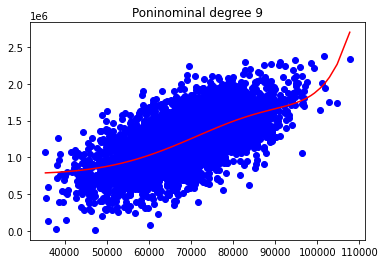

################
[[1.00000000e+00 7.17840162e+04 5.15294499e+09 ... 7.05053420e+38
  5.06115662e+43 3.63310149e+48]
 [1.00000000e+00 7.61754939e+04 5.80270588e+09 ... 1.13376287e+39
  8.63649469e+43 6.57889248e+48]
 [1.00000000e+00 6.94018472e+04 4.81661640e+09 ... 5.38230419e+38
  3.73541853e+43 2.59244946e+48]
 ...
 [1.00000000e+00 6.67909603e+04 4.46103238e+09 ... 3.96042235e+38
  2.64520412e+43 1.76675724e+48]
 [1.00000000e+00 5.99331380e+04 3.59198103e+09 ... 1.66470060e+38
  9.97707310e+42 5.97957299e+47]
 [1.00000000e+00 5.99128239e+04 3.58954647e+09 ... 1.66019201e+38
  9.94667915e+42 5.95933637e+47]]
(4000, 11)
y_pred (4000,)
Score: 0.3941940880762467


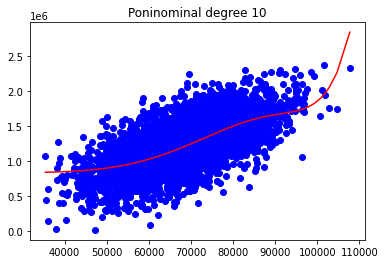

################
[[ 1.          6.4605773  41.73905906]
 [ 1.          6.41984303 41.21438452]
 [ 1.          5.89536032 34.7552733 ]
 ...
 [ 1.          6.45976436 41.72855563]
 [ 1.          5.6373121  31.77928769]
 [ 1.          4.49651279 20.2186273 ]]
(4000, 3)
y_pred (4000,)
Score: 0.2089695164950761


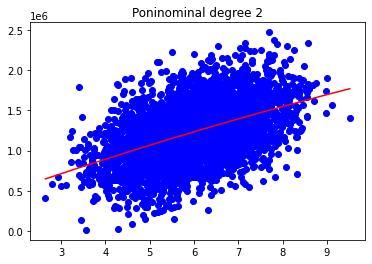

################
[[  1.           6.4605773   41.73905906 269.65841747]
 [  1.           6.41984303  41.21438452 264.58987921]
 [  1.           5.89536032  34.7552733  204.89485909]
 ...
 [  1.           6.45976436  41.72855563 269.55663655]
 [  1.           5.6373121   31.77928769 179.14976295]
 [  1.           4.49651279  20.2186273   90.91331631]]
(4000, 4)
y_pred (4000,)
Score: 0.20934498884991248


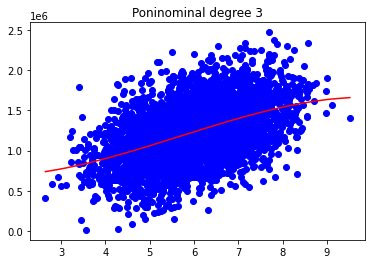

################
[[1.00000000e+00 6.46057730e+00 4.17390591e+01 2.69658417e+02
  1.74214905e+03]
 [1.00000000e+00 6.41984303e+00 4.12143845e+01 2.64589879e+02
  1.69862549e+03]
 [1.00000000e+00 5.89536032e+00 3.47552733e+01 2.04894859e+02
  1.20792902e+03]
 ...
 [1.00000000e+00 6.45976436e+00 4.17285556e+01 2.69556637e+02
  1.74127235e+03]
 [1.00000000e+00 5.63731210e+00 3.17792877e+01 1.79149763e+02
  1.00992313e+03]
 [1.00000000e+00 4.49651279e+00 2.02186273e+01 9.09133163e+01
  4.08792890e+02]]
(4000, 5)
y_pred (4000,)
Score: 0.20936537016832235


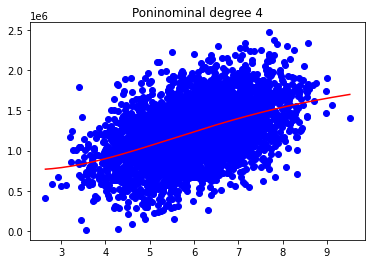

################
[[1.00000000e+00 6.46057730e+00 4.17390591e+01 2.69658417e+02
  1.74214905e+03 1.12552886e+04]
 [1.00000000e+00 6.41984303e+00 4.12143845e+01 2.64589879e+02
  1.69862549e+03 1.09049090e+04]
 [1.00000000e+00 5.89536032e+00 3.47552733e+01 2.04894859e+02
  1.20792902e+03 7.12117683e+03]
 ...
 [1.00000000e+00 6.45976436e+00 4.17285556e+01 2.69556637e+02
  1.74127235e+03 1.12482091e+04]
 [1.00000000e+00 5.63731210e+00 3.17792877e+01 1.79149763e+02
  1.00992313e+03 5.69325186e+03]
 [1.00000000e+00 4.49651279e+00 2.02186273e+01 9.09133163e+01
  4.08792890e+02 1.83814246e+03]]
(4000, 6)
y_pred (4000,)
Score: 0.20959597427903187


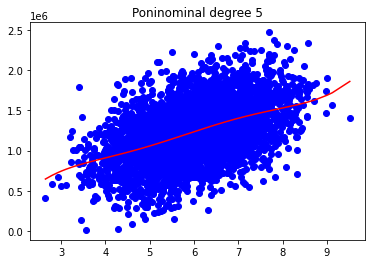

################
[[1.00000000e+00 6.46057730e+00 4.17390591e+01 ... 1.74214905e+03
  1.12552886e+04 7.27156621e+04]
 [1.00000000e+00 6.41984303e+00 4.12143845e+01 ... 1.69862549e+03
  1.09049090e+04 7.00078042e+04]
 [1.00000000e+00 5.89536032e+00 3.47552733e+01 ... 1.20792902e+03
  7.12117683e+03 4.19819033e+04]
 ...
 [1.00000000e+00 6.45976436e+00 4.17285556e+01 ... 1.74127235e+03
  1.12482091e+04 7.26607803e+04]
 [1.00000000e+00 5.63731210e+00 3.17792877e+01 ... 1.00992313e+03
  5.69325186e+03 3.20946376e+04]
 [1.00000000e+00 4.49651279e+00 2.02186273e+01 ... 4.08792890e+02
  1.83814246e+03 8.26523108e+03]]
(4000, 7)
y_pred (4000,)
Score: 0.21058698389281505


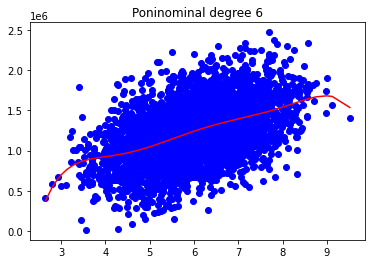

################
[[1.00000000e+00 6.46057730e+00 4.17390591e+01 ... 1.12552886e+04
  7.27156621e+04 4.69785156e+05]
 [1.00000000e+00 6.41984303e+00 4.12143845e+01 ... 1.09049090e+04
  7.00078042e+04 4.49439114e+05]
 [1.00000000e+00 5.89536032e+00 3.47552733e+01 ... 7.12117683e+03
  4.19819033e+04 2.47498447e+05]
 ...
 [1.00000000e+00 6.45976436e+00 4.17285556e+01 ... 1.12482091e+04
  7.26607803e+04 4.69371519e+05]
 [1.00000000e+00 5.63731210e+00 3.17792877e+01 ... 5.69325186e+03
  3.20946376e+04 1.80927489e+05]
 [1.00000000e+00 4.49651279e+00 2.02186273e+01 ... 1.83814246e+03
  8.26523108e+03 3.71647173e+04]]
(4000, 8)
y_pred (4000,)
Score: 0.2110408475677581


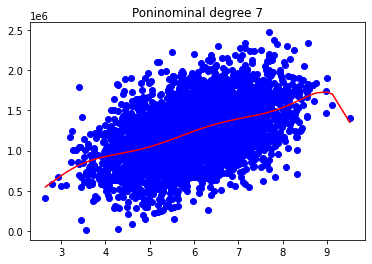

################
[[1.00000000e+00 6.46057730e+00 4.17390591e+01 ... 7.27156621e+04
  4.69785156e+05 3.03508332e+06]
 [1.00000000e+00 6.41984303e+00 4.12143845e+01 ... 7.00078042e+04
  4.49439114e+05 2.88532856e+06]
 [1.00000000e+00 5.89536032e+00 3.47552733e+01 ... 4.19819033e+04
  2.47498447e+05 1.45909252e+06]
 ...
 [1.00000000e+00 6.45976436e+00 4.17285556e+01 ... 7.26607803e+04
  4.69371519e+05 3.03202941e+06]
 [1.00000000e+00 5.63731210e+00 3.17792877e+01 ... 3.20946376e+04
  1.80927489e+05 1.01994472e+06]
 [1.00000000e+00 4.49651279e+00 2.02186273e+01 ... 8.26523108e+03
  3.71647173e+04 1.67111627e+05]]
(4000, 9)
y_pred (4000,)
Score: 0.21104158132175


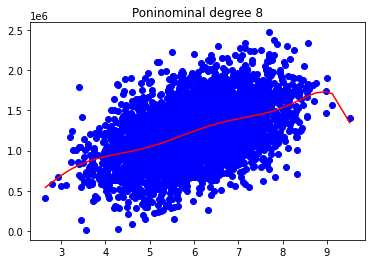

################
[[1.00000000e+00 6.46057730e+00 4.17390591e+01 ... 4.69785156e+05
  3.03508332e+06 1.96083904e+07]
 [1.00000000e+00 6.41984303e+00 4.12143845e+01 ... 4.49439114e+05
  2.88532856e+06 1.85233565e+07]
 [1.00000000e+00 5.89536032e+00 3.47552733e+01 ... 2.47498447e+05
  1.45909252e+06 8.60187616e+06]
 ...
 [1.00000000e+00 6.45976436e+00 4.17285556e+01 ... 4.69371519e+05
  3.03202941e+06 1.95861955e+07]
 [1.00000000e+00 5.63731210e+00 3.17792877e+01 ... 1.80927489e+05
  1.01994472e+06 5.74974671e+06]
 [1.00000000e+00 4.49651279e+00 2.02186273e+01 ... 3.71647173e+04
  1.67111627e+05 7.51419568e+05]]
(4000, 10)
y_pred (4000,)
Score: 0.21151050509501068


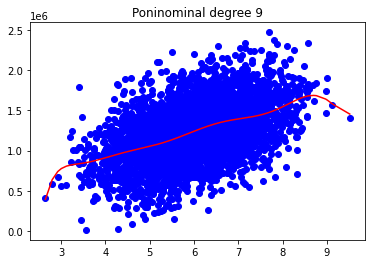

################
[[1.00000000e+00 6.46057730e+00 4.17390591e+01 ... 3.03508332e+06
  1.96083904e+07 1.26681522e+08]
 [1.00000000e+00 6.41984303e+00 4.12143845e+01 ... 2.88532856e+06
  1.85233565e+07 1.18917041e+08]
 [1.00000000e+00 5.89536032e+00 3.47552733e+01 ... 1.45909252e+06
  8.60187616e+06 5.07111594e+07]
 ...
 [1.00000000e+00 6.45976436e+00 4.17285556e+01 ... 3.03202941e+06
  1.95861955e+07 1.26522208e+08]
 [1.00000000e+00 5.63731210e+00 3.17792877e+01 ... 1.01994472e+06
  5.74974671e+06 3.24131167e+07]
 [1.00000000e+00 4.49651279e+00 2.02186273e+01 ... 1.67111627e+05
  7.51419568e+05 3.37876770e+06]]
(4000, 11)
y_pred (4000,)
Score: 0.21191591112147656


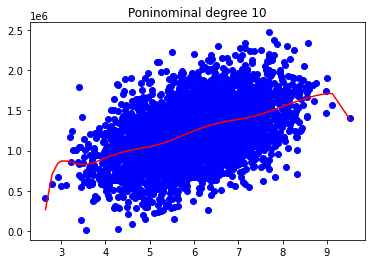

################
[[ 1.          8.93311999 79.80063267]
 [ 1.          7.79436425 60.752114  ]
 [ 1.          7.39216407 54.64408957]
 ...
 [ 1.          7.69585641 59.2262059 ]
 [ 1.          4.62087049 21.35244404]
 [ 1.          6.93654802 48.11569849]]
(4000, 3)
y_pred (4000,)
Score: 0.11346284640770077


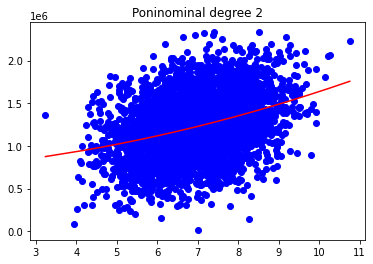

################
[[  1.           8.93311999  79.80063267 712.86862651]
 [  1.           7.79436425  60.752114   473.52410524]
 [  1.           7.39216407  54.64408957 403.93807534]
 ...
 [  1.           7.69585641  59.2262059  455.79637636]
 [  1.           4.62087049  21.35244404  98.66687848]
 [  1.           6.93654802  48.11569849 333.75685333]]
(4000, 4)
y_pred (4000,)
Score: 0.11397099726316462


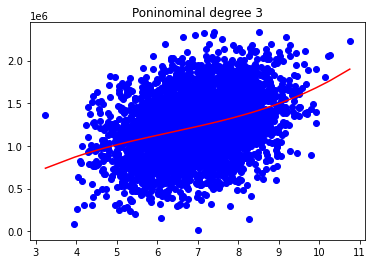

################
[[1.00000000e+00 8.93311999e+00 7.98006327e+01 7.12868627e+02
  6.36814097e+03]
 [1.00000000e+00 7.79436425e+00 6.07521140e+01 4.73524105e+02
  3.69081936e+03]
 [1.00000000e+00 7.39216407e+00 5.46440896e+01 4.03938075e+02
  2.98597653e+03]
 ...
 [1.00000000e+00 7.69585641e+00 5.92262059e+01 4.55796376e+02
  3.50774347e+03]
 [1.00000000e+00 4.62087049e+00 2.13524440e+01 9.86668785e+01
  4.55926867e+02]
 [1.00000000e+00 6.93654802e+00 4.81156985e+01 3.33756853e+02
  2.31512044e+03]]
(4000, 5)
y_pred (4000,)
Score: 0.11438427075088997


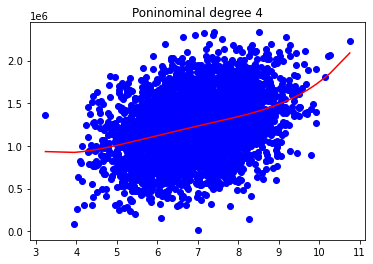

################
[[1.00000000e+00 8.93311999e+00 7.98006327e+01 7.12868627e+02
  6.36814097e+03 5.68873674e+04]
 [1.00000000e+00 7.79436425e+00 6.07521140e+01 4.73524105e+02
  3.69081936e+03 2.87675904e+04]
 [1.00000000e+00 7.39216407e+00 5.46440896e+01 4.03938075e+02
  2.98597653e+03 2.20728284e+04]
 ...
 [1.00000000e+00 7.69585641e+00 5.92262059e+01 4.55796376e+02
  3.50774347e+03 2.69950900e+04]
 [1.00000000e+00 4.62087049e+00 2.13524440e+01 9.86668785e+01
  4.55926867e+02 2.10677900e+03]
 [1.00000000e+00 6.93654802e+00 4.81156985e+01 3.33756853e+02
  2.31512044e+03 1.60589441e+04]]
(4000, 6)
y_pred (4000,)
Score: 0.11439197318605754


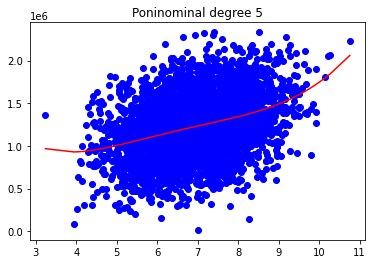

################
[[1.00000000e+00 8.93311999e+00 7.98006327e+01 ... 6.36814097e+03
  5.68873674e+04 5.08181679e+05]
 [1.00000000e+00 7.79436425e+00 6.07521140e+01 ... 3.69081936e+03
  2.87675904e+04 2.24225078e+05]
 [1.00000000e+00 7.39216407e+00 5.46440896e+01 ... 2.98597653e+03
  2.20728284e+04 1.63165969e+05]
 ...
 [1.00000000e+00 7.69585641e+00 5.92262059e+01 ... 3.50774347e+03
  2.69950900e+04 2.07750337e+05]
 [1.00000000e+00 4.62087049e+00 2.13524440e+01 ... 4.55926867e+02
  2.10677900e+03 9.73515291e+03]
 [1.00000000e+00 6.93654802e+00 4.81156985e+01 ... 2.31512044e+03
  1.60589441e+04 1.11393637e+05]]
(4000, 7)
y_pred (4000,)
Score: 0.11454007389266008


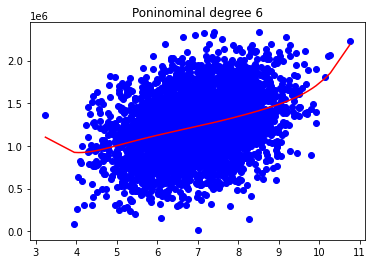

################
[[1.00000000e+00 8.93311999e+00 7.98006327e+01 ... 5.68873674e+04
  5.08181679e+05 4.53964791e+06]
 [1.00000000e+00 7.79436425e+00 6.07521140e+01 ... 2.87675904e+04
  2.24225078e+05 1.74769193e+06]
 [1.00000000e+00 7.39216407e+00 5.46440896e+01 ... 2.20728284e+04
  1.63165969e+05 1.20614961e+06]
 ...
 [1.00000000e+00 7.69585641e+00 5.92262059e+01 ... 2.69950900e+04
  2.07750337e+05 1.59881676e+06]
 [1.00000000e+00 4.62087049e+00 2.13524440e+01 ... 2.10677900e+03
  9.73515291e+03 4.49848807e+04]
 [1.00000000e+00 6.93654802e+00 4.81156985e+01 ... 1.60589441e+04
  1.11393637e+05 7.72687314e+05]]
(4000, 8)
y_pred (4000,)
Score: 0.11455037567384474


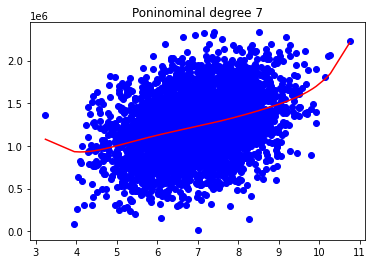

################
[[1.00000000e+00 8.93311999e+00 7.98006327e+01 ... 5.08181679e+05
  4.53964791e+06 4.05532195e+07]
 [1.00000000e+00 7.79436425e+00 6.07521140e+01 ... 2.24225078e+05
  1.74769193e+06 1.36221475e+07]
 [1.00000000e+00 7.39216407e+00 5.46440896e+01 ... 1.63165969e+05
  1.20614961e+06 8.91605581e+06]
 ...
 [1.00000000e+00 7.69585641e+00 5.92262059e+01 ... 2.07750337e+05
  1.59881676e+06 1.23042642e+07]
 [1.00000000e+00 4.62087049e+00 2.13524440e+01 ... 9.73515291e+03
  4.49848807e+04 2.07869308e+05]
 [1.00000000e+00 6.93654802e+00 4.81156985e+01 ... 1.11393637e+05
  7.72687314e+05 5.35978266e+06]]
(4000, 9)
y_pred (4000,)
Score: 0.11554351271199459


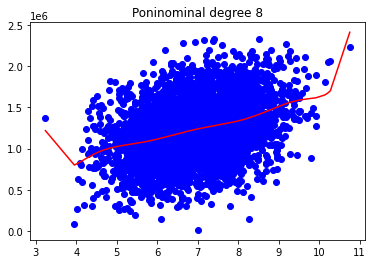

################
[[1.00000000e+00 8.93311999e+00 7.98006327e+01 ... 4.53964791e+06
  4.05532195e+07 3.62266775e+08]
 [1.00000000e+00 7.79436425e+00 6.07521140e+01 ... 1.74769193e+06
  1.36221475e+07 1.06175980e+08]
 [1.00000000e+00 7.39216407e+00 5.46440896e+01 ... 1.20614961e+06
  8.91605581e+06 6.59089474e+07]
 ...
 [1.00000000e+00 7.69585641e+00 5.92262059e+01 ... 1.59881676e+06
  1.23042642e+07 9.46918507e+07]
 [1.00000000e+00 4.62087049e+00 2.13524440e+01 ... 4.49848807e+04
  2.07869308e+05 9.60537149e+05]
 [1.00000000e+00 6.93654802e+00 4.81156985e+01 ... 7.72687314e+05
  5.35978266e+06 3.71783898e+07]]
(4000, 10)
y_pred (4000,)
Score: 0.11703900809728185


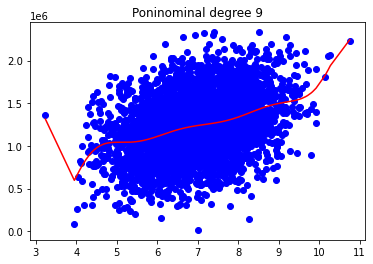

################
[[1.00000000e+00 8.93311999e+00 7.98006327e+01 ... 4.05532195e+07
  3.62266775e+08 3.23617257e+09]
 [1.00000000e+00 7.79436425e+00 6.07521140e+01 ... 1.36221475e+07
  1.06175980e+08 8.27574259e+08]
 [1.00000000e+00 7.39216407e+00 5.46440896e+01 ... 8.91605581e+06
  6.59089474e+07 4.87209752e+08]
 ...
 [1.00000000e+00 7.69585641e+00 5.92262059e+01 ... 1.23042642e+07
  9.46918507e+07 7.28734886e+08]
 [1.00000000e+00 4.62087049e+00 2.13524440e+01 ... 2.07869308e+05
  9.60537149e+05 4.43851776e+06]
 [1.00000000e+00 6.93654802e+00 4.81156985e+01 ... 5.35978266e+06
  3.71783898e+07 2.57889686e+08]]
(4000, 11)
y_pred (4000,)
Score: 0.11730103839197448


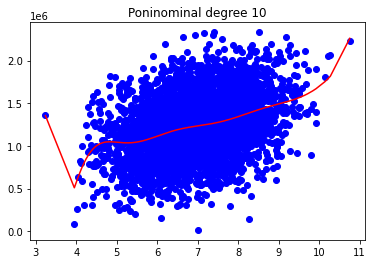

################
[[ 1.      5.1    26.01  ]
 [ 1.      6.49   42.1201]
 [ 1.      6.1    37.21  ]
 ...
 [ 1.      4.02   16.1604]
 [ 1.      3.23   10.4329]
 [ 1.      4.49   20.1601]]
(4000, 3)
y_pred (4000,)
Score: 0.028403728234096093


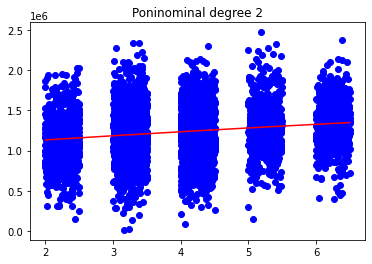

################
[[  1.         5.1       26.01     132.651   ]
 [  1.         6.49      42.1201   273.359449]
 [  1.         6.1       37.21     226.981   ]
 ...
 [  1.         4.02      16.1604    64.964808]
 [  1.         3.23      10.4329    33.698267]
 [  1.         4.49      20.1601    90.518849]]
(4000, 4)
y_pred (4000,)
Score: 0.028677990438591205


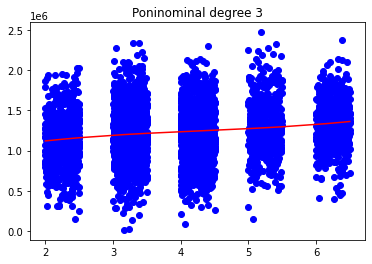

################
[[1.00000000e+00 5.10000000e+00 2.60100000e+01 1.32651000e+02
  6.76520100e+02]
 [1.00000000e+00 6.49000000e+00 4.21201000e+01 2.73359449e+02
  1.77410282e+03]
 [1.00000000e+00 6.10000000e+00 3.72100000e+01 2.26981000e+02
  1.38458410e+03]
 ...
 [1.00000000e+00 4.02000000e+00 1.61604000e+01 6.49648080e+01
  2.61158528e+02]
 [1.00000000e+00 3.23000000e+00 1.04329000e+01 3.36982670e+01
  1.08845402e+02]
 [1.00000000e+00 4.49000000e+00 2.01601000e+01 9.05188490e+01
  4.06429632e+02]]
(4000, 5)
y_pred (4000,)
Score: 0.03244057152878932


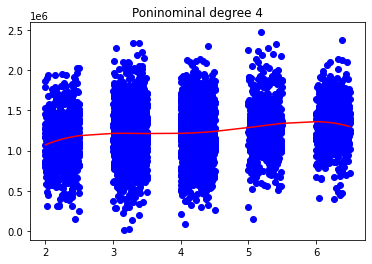

################
[[1.00000000e+00 5.10000000e+00 2.60100000e+01 1.32651000e+02
  6.76520100e+02 3.45025251e+03]
 [1.00000000e+00 6.49000000e+00 4.21201000e+01 2.73359449e+02
  1.77410282e+03 1.15139273e+04]
 [1.00000000e+00 6.10000000e+00 3.72100000e+01 2.26981000e+02
  1.38458410e+03 8.44596301e+03]
 ...
 [1.00000000e+00 4.02000000e+00 1.61604000e+01 6.49648080e+01
  2.61158528e+02 1.04985728e+03]
 [1.00000000e+00 3.23000000e+00 1.04329000e+01 3.36982670e+01
  1.08845402e+02 3.51570650e+02]
 [1.00000000e+00 4.49000000e+00 2.01601000e+01 9.05188490e+01
  4.06429632e+02 1.82486905e+03]]
(4000, 6)
y_pred (4000,)
Score: 0.03259729783119025


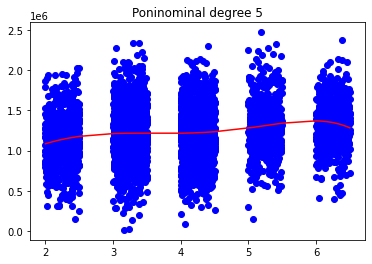

################
[[1.00000000e+00 5.10000000e+00 2.60100000e+01 ... 6.76520100e+02
  3.45025251e+03 1.75962878e+04]
 [1.00000000e+00 6.49000000e+00 4.21201000e+01 ... 1.77410282e+03
  1.15139273e+04 7.47253884e+04]
 [1.00000000e+00 6.10000000e+00 3.72100000e+01 ... 1.38458410e+03
  8.44596301e+03 5.15203744e+04]
 ...
 [1.00000000e+00 4.02000000e+00 1.61604000e+01 ... 2.61158528e+02
  1.04985728e+03 4.22042628e+03]
 [1.00000000e+00 3.23000000e+00 1.04329000e+01 ... 1.08845402e+02
  3.51570650e+02 1.13557320e+03]
 [1.00000000e+00 4.49000000e+00 2.01601000e+01 ... 4.06429632e+02
  1.82486905e+03 8.19366202e+03]]
(4000, 7)
y_pred (4000,)
Score: 0.03385077632730049


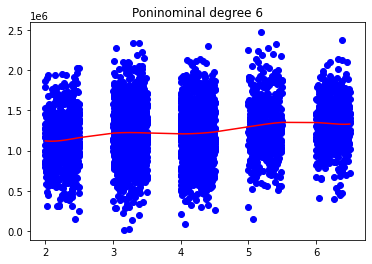

################
[[1.00000000e+00 5.10000000e+00 2.60100000e+01 ... 3.45025251e+03
  1.75962878e+04 8.97410678e+04]
 [1.00000000e+00 6.49000000e+00 4.21201000e+01 ... 1.15139273e+04
  7.47253884e+04 4.84967770e+05]
 [1.00000000e+00 6.10000000e+00 3.72100000e+01 ... 8.44596301e+03
  5.15203744e+04 3.14274284e+05]
 ...
 [1.00000000e+00 4.02000000e+00 1.61604000e+01 ... 1.04985728e+03
  4.22042628e+03 1.69661136e+04]
 [1.00000000e+00 3.23000000e+00 1.04329000e+01 ... 3.51570650e+02
  1.13557320e+03 3.66790143e+03]
 [1.00000000e+00 4.49000000e+00 2.01601000e+01 ... 1.82486905e+03
  8.19366202e+03 3.67895425e+04]]
(4000, 8)
y_pred (4000,)
Score: 0.03387896762192011


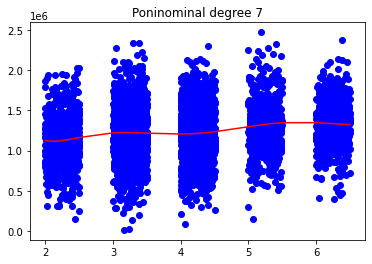

################
[[1.00000000e+00 5.10000000e+00 2.60100000e+01 ... 1.75962878e+04
  8.97410678e+04 4.57679446e+05]
 [1.00000000e+00 6.49000000e+00 4.21201000e+01 ... 7.47253884e+04
  4.84967770e+05 3.14744083e+06]
 [1.00000000e+00 6.10000000e+00 3.72100000e+01 ... 5.15203744e+04
  3.14274284e+05 1.91707313e+06]
 ...
 [1.00000000e+00 4.02000000e+00 1.61604000e+01 ... 4.22042628e+03
  1.69661136e+04 6.82037768e+04]
 [1.00000000e+00 3.23000000e+00 1.04329000e+01 ... 1.13557320e+03
  3.66790143e+03 1.18473216e+04]
 [1.00000000e+00 4.49000000e+00 2.01601000e+01 ... 8.19366202e+03
  3.67895425e+04 1.65185046e+05]]
(4000, 9)
y_pred (4000,)
Score: 0.034014852444827604


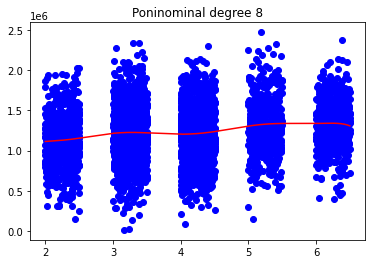

################
[[1.00000000e+00 5.10000000e+00 2.60100000e+01 ... 8.97410678e+04
  4.57679446e+05 2.33416517e+06]
 [1.00000000e+00 6.49000000e+00 4.21201000e+01 ... 4.84967770e+05
  3.14744083e+06 2.04268910e+07]
 [1.00000000e+00 6.10000000e+00 3.72100000e+01 ... 3.14274284e+05
  1.91707313e+06 1.16941461e+07]
 ...
 [1.00000000e+00 4.02000000e+00 1.61604000e+01 ... 1.69661136e+04
  6.82037768e+04 2.74179183e+05]
 [1.00000000e+00 3.23000000e+00 1.04329000e+01 ... 3.66790143e+03
  1.18473216e+04 3.82668489e+04]
 [1.00000000e+00 4.49000000e+00 2.01601000e+01 ... 3.67895425e+04
  1.65185046e+05 7.41680856e+05]]
(4000, 10)
y_pred (4000,)
Score: 0.034054587277009385


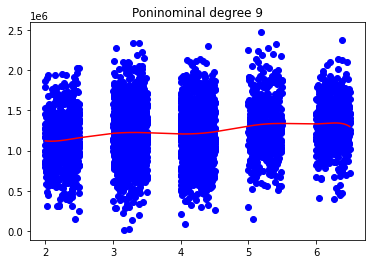

################
[[1.00000000e+00 5.10000000e+00 2.60100000e+01 ... 4.57679446e+05
  2.33416517e+06 1.19042424e+07]
 [1.00000000e+00 6.49000000e+00 4.21201000e+01 ... 3.14744083e+06
  2.04268910e+07 1.32570523e+08]
 [1.00000000e+00 6.10000000e+00 3.72100000e+01 ... 1.91707313e+06
  1.16941461e+07 7.13342912e+07]
 ...
 [1.00000000e+00 4.02000000e+00 1.61604000e+01 ... 6.82037768e+04
  2.74179183e+05 1.10220032e+06]
 [1.00000000e+00 3.23000000e+00 1.04329000e+01 ... 1.18473216e+04
  3.82668489e+04 1.23601922e+05]
 [1.00000000e+00 4.49000000e+00 2.01601000e+01 ... 1.65185046e+05
  7.41680856e+05 3.33014704e+06]]
(4000, 11)
y_pred (4000,)
Score: 0.03406798367738817


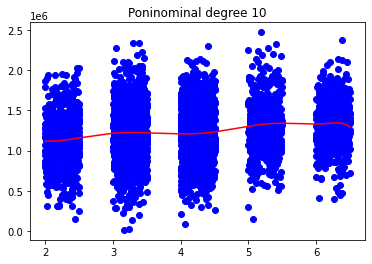

################
[[1.00000000e+00 2.57532831e+04 6.63231591e+08]
 [1.00000000e+00 3.82666544e+04 1.46433684e+09]
 [1.00000000e+00 2.22011255e+04 4.92889973e+08]
 ...
 [1.00000000e+00 4.71184206e+04 2.22014556e+09]
 [1.00000000e+00 2.90851358e+04 8.45945124e+08]
 [1.00000000e+00 2.38865605e+04 5.70567770e+08]]
(4000, 3)
y_pred (4000,)
Score: 0.15569705457103922


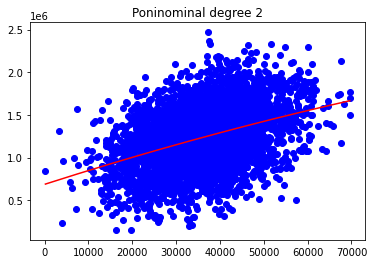

################
[[1.00000000e+00 2.57532831e+04 6.63231591e+08 1.70803909e+13]
 [1.00000000e+00 3.82666544e+04 1.46433684e+09 5.60352718e+13]
 [1.00000000e+00 2.22011255e+04 4.92889973e+08 1.09427122e+13]
 ...
 [1.00000000e+00 4.71184206e+04 2.22014556e+09 1.04609753e+14]
 [1.00000000e+00 2.90851358e+04 8.45945124e+08 2.46044288e+13]
 [1.00000000e+00 2.38865605e+04 5.70567770e+08 1.36289015e+13]]
(4000, 4)
y_pred (4000,)
Score: 0.15578868954186964


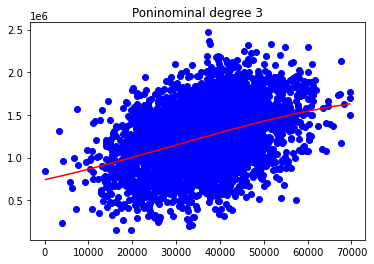

################
[[1.00000000e+00 2.57532831e+04 6.63231591e+08 1.70803909e+13
  4.39876144e+17]
 [1.00000000e+00 3.82666544e+04 1.46433684e+09 5.60352718e+13
  2.14428238e+18]
 [1.00000000e+00 2.22011255e+04 4.92889973e+08 1.09427122e+13
  2.42940526e+17]
 ...
 [1.00000000e+00 4.71184206e+04 2.22014556e+09 1.04609753e+14
  4.92904632e+18]
 [1.00000000e+00 2.90851358e+04 8.45945124e+08 2.46044288e+13
  7.15623153e+17]
 [1.00000000e+00 2.38865605e+04 5.70567770e+08 1.36289015e+13
  3.25547580e+17]]
(4000, 5)
y_pred (4000,)
Score: 0.15584770063884978


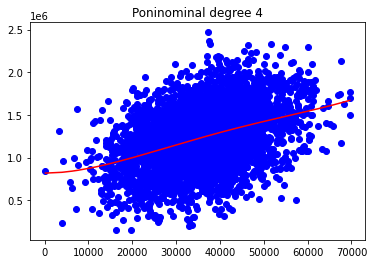

################
[[1.00000000e+00 2.57532831e+04 6.63231591e+08 1.70803909e+13
  4.39876144e+17 1.13282549e+22]
 [1.00000000e+00 3.82666544e+04 1.46433684e+09 5.60352718e+13
  2.14428238e+18 8.20545129e+22]
 [1.00000000e+00 2.22011255e+04 4.92889973e+08 1.09427122e+13
  2.42940526e+17 5.39355311e+21]
 ...
 [1.00000000e+00 4.71184206e+04 2.22014556e+09 1.04609753e+14
  4.92904632e+18 2.32248878e+23]
 [1.00000000e+00 2.90851358e+04 8.45945124e+08 2.46044288e+13
  7.15623153e+17 2.08139966e+22]
 [1.00000000e+00 2.38865605e+04 5.70567770e+08 1.36289015e+13
  3.25547580e+17 7.77621196e+21]]
(4000, 6)
y_pred (4000,)
Score: 0.15530323773513133


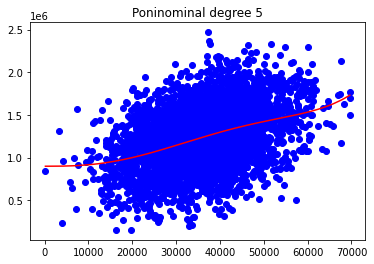

################
[[1.00000000e+00 2.57532831e+04 6.63231591e+08 ... 4.39876144e+17
  1.13282549e+22 2.91739755e+26]
 [1.00000000e+00 3.82666544e+04 1.46433684e+09 ... 2.14428238e+18
  8.20545129e+22 3.13995169e+27]
 [1.00000000e+00 2.22011255e+04 4.92889973e+08 ... 2.42940526e+17
  5.39355311e+21 1.19742949e+26]
 ...
 [1.00000000e+00 4.71184206e+04 2.22014556e+09 ... 4.92904632e+18
  2.32248878e+23 1.09432003e+28]
 [1.00000000e+00 2.90851358e+04 8.45945124e+08 ... 7.15623153e+17
  2.08139966e+22 6.05377916e+26]
 [1.00000000e+00 2.38865605e+04 5.70567770e+08 ... 3.25547580e+17
  7.77621196e+21 1.85746957e+26]]
(4000, 7)
y_pred (4000,)
Score: 0.15353300120669944


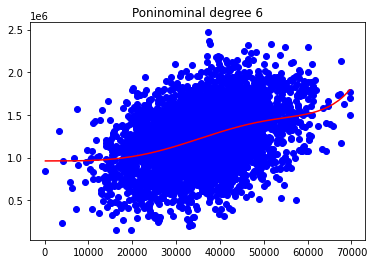

################
[[1.00000000e+00 2.57532831e+04 6.63231591e+08 ... 1.13282549e+22
  2.91739755e+26 7.51325651e+30]
 [1.00000000e+00 3.82666544e+04 1.46433684e+09 ... 8.20545129e+22
  3.13995169e+27 1.20155446e+32]
 [1.00000000e+00 2.22011255e+04 4.92889973e+08 ... 5.39355311e+21
  1.19742949e+26 2.65842825e+30]
 ...
 [1.00000000e+00 4.71184206e+04 2.22014556e+09 ... 2.32248878e+23
  1.09432003e+28 5.15626316e+32]
 [1.00000000e+00 2.90851358e+04 8.45945124e+08 ... 2.08139966e+22
  6.05377916e+26 1.76074989e+31]
 [1.00000000e+00 2.38865605e+04 5.70567770e+08 ... 7.77621196e+21
  1.85746957e+26 4.43685592e+30]]
(4000, 8)
y_pred (4000,)
Score: 0.15026672757313309


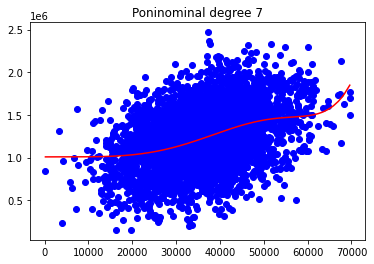

################
[[1.00000000e+00 2.57532831e+04 6.63231591e+08 ... 2.91739755e+26
  7.51325651e+30 1.93491022e+35]
 [1.00000000e+00 3.82666544e+04 1.46433684e+09 ... 3.13995169e+27
  1.20155446e+32 4.59794693e+36]
 [1.00000000e+00 2.22011255e+04 4.92889973e+08 ... 1.19742949e+26
  2.65842825e+30 5.90200991e+34]
 ...
 [1.00000000e+00 4.71184206e+04 2.22014556e+09 ... 1.09432003e+28
  5.15626316e+32 2.42954976e+37]
 [1.00000000e+00 2.90851358e+04 8.45945124e+08 ... 6.05377916e+26
  1.76074989e+31 5.12116497e+35]
 [1.00000000e+00 2.38865605e+04 5.70567770e+08 ... 1.85746957e+26
  4.43685592e+30 1.05981227e+35]]
(4000, 9)
y_pred (4000,)
Score: 0.1455288516436869


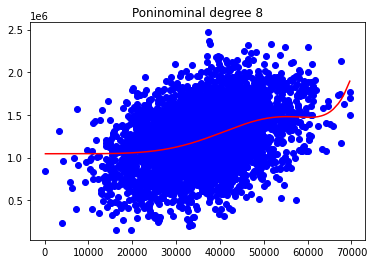

################
[[1.00000000e+00 2.57532831e+04 6.63231591e+08 ... 7.51325651e+30
  1.93491022e+35 4.98302907e+39]
 [1.00000000e+00 3.82666544e+04 1.46433684e+09 ... 1.20155446e+32
  4.59794693e+36 1.75948046e+41]
 [1.00000000e+00 2.22011255e+04 4.92889973e+08 ... 2.65842825e+30
  5.90200991e+34 1.31031263e+39]
 ...
 [1.00000000e+00 4.71184206e+04 2.22014556e+09 ... 5.15626316e+32
  2.42954976e+37 1.14476548e+42]
 [1.00000000e+00 2.90851358e+04 8.45945124e+08 ... 1.76074989e+31
  5.12116497e+35 1.48949778e+40]
 [1.00000000e+00 2.38865605e+04 5.70567770e+08 ... 4.43685592e+30
  1.05981227e+35 2.53152699e+39]]
(4000, 10)
y_pred (4000,)
Score: 0.1395236816532256


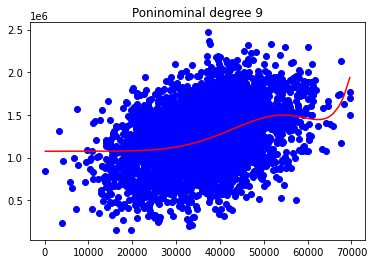

################
[[1.00000000e+00 2.57532831e+04 6.63231591e+08 ... 1.93491022e+35
  4.98302907e+39 1.28329358e+44]
 [1.00000000e+00 3.82666544e+04 1.46433684e+09 ... 4.59794693e+36
  1.75948046e+41 6.73294308e+45]
 [1.00000000e+00 2.22011255e+04 4.92889973e+08 ... 5.90200991e+34
  1.31031263e+39 2.90904151e+43]
 ...
 [1.00000000e+00 4.71184206e+04 2.22014556e+09 ... 2.42954976e+37
  1.14476548e+42 5.39395413e+46]
 [1.00000000e+00 2.90851358e+04 8.45945124e+08 ... 5.12116497e+35
  1.48949778e+40 4.33222453e+44]
 [1.00000000e+00 2.38865605e+04 5.70567770e+08 ... 1.05981227e+35
  2.53152699e+39 6.04694725e+43]]
(4000, 11)
y_pred (4000,)
Score: 0.1325221485960777


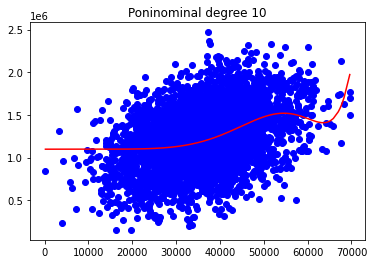

KeyError: 'Price'

In [27]:
# Non linear regression polinomyal
degree_min = 2
degree_max = 10
scores = []
# Make a pipeline model with polynomial transformation and LASSO regression with cross-validation, run it for increasing degree of polynomial (complexity of the model)
 #NO PASAR EN ARRAY BRUTO. SE DE PASAR COMO DATAFRAME
for elem in df.columns:
    X_train, X_test, y_train, y_test = train_test_split(X[elem].values, y,test_size=0.2)
    
    for degree in range(degree_min,degree_max+1):
        print("################")
        polinominal_model = PolynomialFeatures(degree) 
        X_poly = polinominal_model.fit_transform(X_train.reshape(-1,1),y_train)

        #######
        print(X_poly)
        print(X_poly.shape)

        lin_reg_model = LinearRegression()
        lin_reg_model.fit(X_poly, y_train)
        y_pred = lin_reg_model.predict(X_poly)

        print("y_pred", y_pred.shape)
        print("Score:", r2_score(y_train, y_pred))

        X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train, y_train)))
        plt.scatter(X_train_to_show, y_train_to_show, color='b')
        X_train_to_show, y_pred = zip(*sorted(zip(X_train, y_pred)))
        plt.plot(X_train_to_show, y_pred, color='red')
        plt.title("Poninominal degree " + str(degree))
        plt.show()

        
S

## SVR
1. estandarizarlos
2. split
3. entreno el modelo
4. 

In [3]:
X1 = df.iloc[:,3]
X1.shape

(5000,)

In [4]:
X1 = np.array(X1)

In [5]:
X1 = X1.reshape(-1,1)

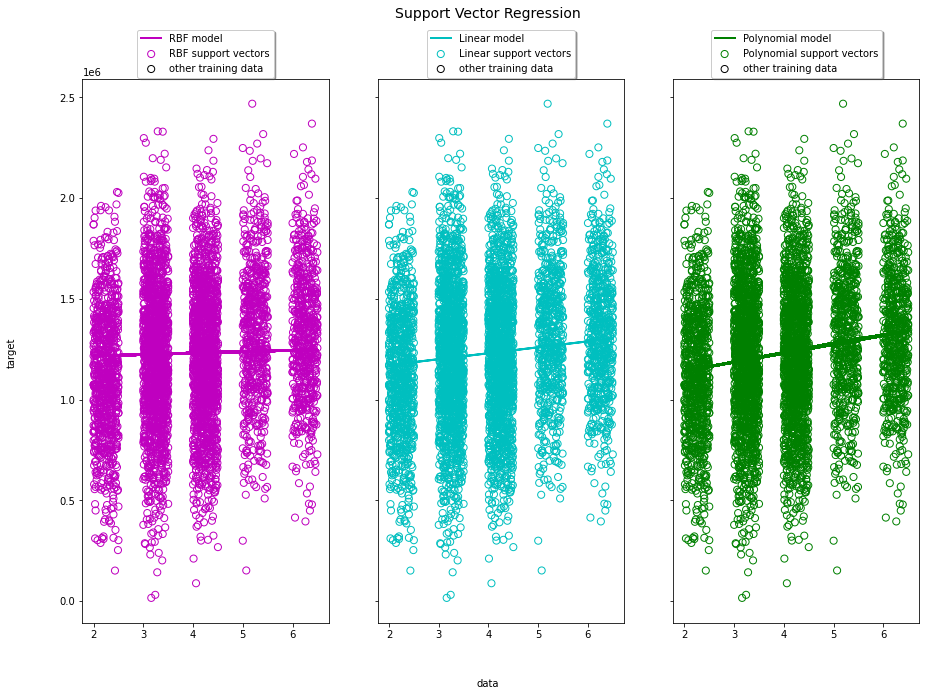

In [8]:
import numpy as np
from sklearn.svm import SVR
import matplotlib.pyplot as plt

svr_rbf = SVR(kernel='rbf', C=100, gamma=0.1, epsilon=.1)
svr_lin = SVR(kernel='linear', C=100, gamma='auto')
svr_poly = SVR(kernel='poly', C=100, gamma='auto', degree=3, epsilon=.1, coef0=1)

svrs = [svr_rbf, svr_lin, svr_poly]
kernel_label = ['RBF', 'Linear', 'Polynomial']
model_color = ['m', 'c', 'g']
lw = 2
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(15, 10), sharey=True)
for ix, svr in enumerate(svrs):
    model = svr.fit(X1, y)
    y_prediction = model.predict(X1)
    axes[ix].plot(X1, y_prediction, color=model_color[ix], lw=lw,
                  label='{} model'.format(kernel_label[ix]))
    axes[ix].scatter(X1[svr.support_], y[svr.support_], facecolor="none",
                     edgecolor=model_color[ix], s=50,
                     label='{} support vectors'.format(kernel_label[ix]))
    axes[ix].scatter(X1[np.setdiff1d(np.arange(len(X1)), svr.support_)],
                     y[np.setdiff1d(np.arange(len(X1)), svr.support_)],
                     facecolor="none", edgecolor="k", s=50,
                     label='other training data')
    axes[ix].legend(loc='upper center', bbox_to_anchor=(0.5, 1.1),
                    ncol=1, fancybox=True, shadow=True)


fig.text(0.5, 0.04, 'data', ha='center', va='center')
fig.text(0.06, 0.5, 'target', ha='center', va='center', rotation='vertical')
fig.suptitle("Support Vector Regression", fontsize=14)
plt.show()

In [9]:
X_train, X_test, y_train, y_test = train_test_split(X1, y,test_size=0.2)



In [18]:
model = svr.fit(X_train, y_train)
y_prediction = model.predict(X1)
y_prediction

array([1237928.65676708, 1186510.75943866, 1289351.93114949, ...,
       1141475.078885  , 1303204.79580454, 1236896.63349292])

In [19]:
model.score(X_test,y_test)

0.027624002686969407

### 2. Se pide:

En el anterior dataset, la columna "Avg. Area Number of Bedrooms" está en un rango numérico limitado:

1. Cambia todos los datos para que sean enteros redondeando hacia el entero más cercano. Si es .5 exacto, se redondea hacia abajo.

2. Cuando lo hayas hecho, tendras una columna con números enteros en un rango limitado. Ahora trata a esa columna como una serie de valores discretos (classes, labels). 

3. Usando las demás columnas numéricas y una a una, utiliza SVM para clasificar esa columna modificada.

4. Usando todas las demás columnas a la vez, utiliza SVM para clasificar esa columna modificada. Es decir, "Avg. Area Income" con nuestro target, después "Avg. Area House Age", ... ¿hace aumentar el score? ¿por qué? 

5. ¿Qué columna tiene mejor correlación con "Avg. Area Number of Bedrooms" una vez modificada? ¿qué columna da mejor score para nuestro target? 

In [3]:
import numpy as np
from sklearn import svm


In [4]:
df["Avg. Area Number of Bedrooms"] = np.round(df["Avg. Area Number of Bedrooms"],decimals = 0)
df["Avg. Area Number of Bedrooms"] = df["Avg. Area Number of Bedrooms"].astype(int)
df.head(5)



,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price,Address
0,79545.458574,5.682861,7.009188,4,23086.800503,1.059034e+06,"208 Michael Ferry Apt. 674\nLaurabury, NE 3701..."
1,79248.642455,6.002900,6.730821,3,40173.072174,1.505891e+06,"188 Johnson Views Suite 079\nLake Kathleen, CA..."
2,61287.067179,5.865890,8.512727,5,36882.159400,1.058988e+06,"9127 Elizabeth Stravenue\nDanieltown, WI 06482..."
3,63345.240046,7.188236,5.586729,3,34310.242831,1.260617e+06,USS Barnett\nFPO AP 44820
4,59982.197226,5.040555,7.839388,4,26354.109472,6.309435e+05,USNS Raymond\nFPO AE 09386


In [5]:
df1 = df.copy()
df1.dtypes

Avg. Area Income                float64
Avg. Area House Age             float64
Avg. Area Number of Rooms       float64
Avg. Area Number of Bedrooms      int64
Area Population                 float64
Price                           float64
Address                          object
dtype: object

In [6]:
df1.columns

Index(['Avg. Area Income', 'Avg. Area House Age', 'Avg. Area Number of Rooms',
       'Avg. Area Number of Bedrooms', 'Area Population', 'Price', 'Address'],
      dtype='object')

In [11]:
X_1 = df1.drop(["Avg. Area Number of Bedrooms", "Address"],1)
X_1

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Area Population,Price
0,79545.458574,5.682861,7.009188,23086.800503,1.059034e+06
1,79248.642455,6.002900,6.730821,40173.072174,1.505891e+06
2,61287.067179,5.865890,8.512727,36882.159400,1.058988e+06
3,63345.240046,7.188236,5.586729,34310.242831,1.260617e+06
4,59982.197226,5.040555,7.839388,26354.109472,6.309435e+05
...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,22837.361035,1.060194e+06
4996,78491.275435,6.999135,6.576763,25616.115489,1.482618e+06
4997,63390.686886,7.250591,4.805081,33266.145490,1.030730e+06
4998,68001.331235,5.534388,7.130144,42625.620156,1.198657e+06


In [12]:
X_1Col = ['Avg. Area Income', 'Avg. Area House Age', 'Avg. Area Number of Rooms',
       'Area Population', 'Price']
X_1Col

['Avg. Area Income',
 'Avg. Area House Age',
 'Avg. Area Number of Rooms',
 'Area Population',
 'Price']

In [13]:
c1 = np.array(X_1['Avg. Area Income'])

In [15]:
c1 = c1.reshape(-1,1)

In [16]:
y2 = df1["Avg. Area Number of Bedrooms"].values
y2.shape

(5000,)

In [17]:
C = 100
gamma = 10

# rbf -- Radial basis function
clf = svm.SVC(C=C, kernel='rbf', gamma=gamma)
clf.fit(c1, y2)
print ('score:', clf.score(c1, y2))
"""
plt.figure()
visualize_boundary(X, y, clf)
plt.xlim([0, 1])
plt.ylim([0.4, 1])
plt.title("Dataset 2")
plt.show()"""

score: 0.9988


'\nplt.figure()\nvisualize_boundary(X, y, clf)\nplt.xlim([0, 1])\nplt.ylim([0.4, 1])\nplt.title("Dataset 2")\nplt.show()'

In [18]:
C = 1
gamma = 10
kernel='rbf'
for elem in X_1.columns:
    X_train, X_test, y_train, y_test = train_test_split(X_1[elem].values.reshape(-1,1), y2, test_size = 0.20)
    clf = svm.SVC(C=C, kernel= kernel, gamma=gamma)
    clf.fit(X_train, y_train)
    print ('score:', clf.score(X_test, y_test))

score: 0.275
score: 0.324
score: 0.285
score: 0.286
score: 0.285


In [21]:
def data3_params(X, y):
    C_cands = [0.01, 0.03] #, 0.1, 0.3, 1, 3, 10, 30]
    gamma_cands = [0.01, 0.03] #, 0.1, 0.3, 1, 3, 10, 30]
    max_score = -1
    C_pick = -1
    gamma_pick = -1
    kernel_cands = ['rbf'] # ,'linear', 'poly' ]
    kernel_pick = -1

    for C in C_cands:
        for gamma in gamma_cands:
            for kernel in kernel_cands:
                clf = svm.SVC(C=C, kernel=kernel, gamma=gamma)
                clf.fit(X_train, y_train)
                score = clf.score(X_test, y_test)
                if score > max_score:
                    max_score = score
                    C_pick = C
                    gamma_pick = gamma
                    kernel_pick = kernel


    return C_pick, gamma_pick,kernel_pick

In [20]:
for elem in X_1.columns:
    X_train, X_test, y_train, y_test = train_test_split(X_1[elem].values.reshape(-1,1), y2, test_size = 0.20)
    C, gamma,kernel = data3_params(X_train, y_train)
    print("C", C)
    print("gamma", gamma)
    print('kernel', kernel)
    # Train the SVM
    clf = svm.SVC(C=C, kernel=kernel, gamma=gamma)
    clf.fit(X_train, y_train)
    print ('score:', clf.score(X_test, y_test))

C 0.01
gamma 0.01
kernel rbf
score: 0.284
C 0.01
gamma 0.01
kernel rbf
score: 0.308
C 0.01
gamma 0.01
kernel rbf
score: 0.287
C 0.01
gamma 0.01
kernel rbf
score: 0.292
C 0.01
gamma 0.01
kernel rbf
score: 0.282
